# Imports, config and setting global variables

In [8]:
import os
import json
import numpy as np
import pandas as pd
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import linregress, pearsonr

from tqdm import tqdm
tqdm.pandas()

from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Lasso, Ridge, ElasticNet
from sklearn.datasets import fetch_california_housing, load_diabetes


In [9]:
import logging

if not os.path.exists('logs'):
    os.makedirs('logs')

LOGGING_FILE = os.path.join('logs', 'experiments.log')

logging.basicConfig(level=logging.DEBUG, format='%(asctime)s - %(levelname)s - %(message)s', 
                    datefmt='%Y-%m-%d %H:%M:%S', 
                    handlers=[logging.StreamHandler(), 
                              logging.FileHandler(LOGGING_FILE)])


In [10]:
N_SAMPLES = 1_000

MIN_LAMBDA_LOG_10 = -2
MAX_LAMBDA_LOG_10 = 2
NUM_LAMBDAS = 100

logging.info(f'Generating {N_SAMPLES} samples')
logging.info(f'''Using {NUM_LAMBDAS} lambdas equally spaced in log space from 10^({MIN_LAMBDA_LOG_10}) to 10^{MAX_LAMBDA_LOG_10}''')

LAMBDAS = np.logspace(MIN_LAMBDA_LOG_10, MAX_LAMBDA_LOG_10, NUM_LAMBDAS)

DGP_OPTIONS = ["3x_1 - 2x_2", "optim_slides", "california_housing", "diabetes", ]

DGP = DGP_OPTIONS[0]

# DGP1
MIN_THETA = -5
MAX_THETA = 5
N_VALUES_FOR_EACH_THETA = 50

# DGP 2
CORR_AMOUNT = 0.99

REPORT = {"MIN_LAMBDA_LOG_10": MIN_LAMBDA_LOG_10,
        "MAX_LAMBDA_LOG_10": MAX_LAMBDA_LOG_10,
        "NUM_LAMBDAS": NUM_LAMBDAS,
        "LAMBDAS": LAMBDAS,
        "DGP": DGP,
        "MIN_THETA": MIN_THETA,
        "MAX_THETA": MAX_THETA,
        "N_VALUES_FOR_EACH_THETA": N_VALUES_FOR_EACH_THETA}
if DGP == "optim_slides":
    REPORT["CORR_AMOUNT"] = CORR_AMOUNT

2024-12-09 05:20:40 - INFO - Generating 1000 samples
2024-12-09 05:20:40 - INFO - Using 100 lambdas equally spaced in log space from 10^(-2) to 10^2


# Helper functions

## ERM, Filtering lambda, tuplet structure, plots

In [11]:
def empirical_risk(X, y, theta):
    # In the slides we don't divide by num samples, but it did not matter
    return np.mean((y - X @ theta)**2)


In [12]:
def filter_lambda_closest(df, target_lambda):
    """Filter the dataframe to the row with the lambda closest to the target_lambda
    
    We need this for replicating slide 327 (theta getting pulled to the origin)
    """
    
    closest_row = df.iloc[(df['lambda'] - target_lambda).abs().argsort()[:1]]
    return closest_row

In [13]:
def get_tuplet_structure(param, n_features):
    """Used for DGP from Optimization slides
    
    param = 0 -> identity matrix (no correlation)
    param = 1 -> all ones matrix (full correlation)
    """
    return np.array([[param**(abs(i-j)) for j in range(n_features)] for i in range(n_features)])


In [14]:
def create_plots(df, norms, dgp, reg):
    figs = {}
    for norm in norms:
        title = f'{dgp} | {reg} | {norm} of the coefficients'
        fig = px.line(df, x='lambda', y=[norm], title=title, labels={'value': 'Norm', 'variable': 'Lambda'}, markers=True)
        figs[norm] = {
            'base': fig,
            'log': go.Figure(fig).update_xaxes(type="log", title_text="Log-scaled Lambda"),
            'narrow': go.Figure(fig).update_xaxes(range=[0.01, 10], title_text="Lambda (0.01-10)"),
            'super_narrow': go.Figure(fig).update_xaxes(range=[0.01, 1], title_text="Lambda (0.01-1)")
        }
    combined_title = f'{dgp} | {reg} | L1 and L2 norms of the coefficients'
    combined_fig = px.line(
        df, x='lambda', y=norms, title=combined_title, labels={'value': 'Norm', 'variable': 'Norm Type'}, markers=True
    )
    figs['combined'] = {
        'base': combined_fig,
        'log': go.Figure(combined_fig).update_xaxes(type="log", title_text="Log-scaled Lambda"),
        'narrow': go.Figure(combined_fig).update_xaxes(range=[0.01, 10], title_text="Lambda (0.01-10)"),
        'super_narrow': go.Figure(combined_fig).update_xaxes(range=[0.01, 1], title_text="Lambda (0.01-1)")
    }
    return figs


## Data Generating Processes 

- DGP from slide 327

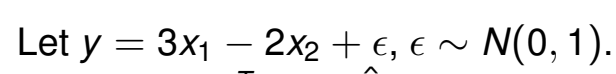

- DGP stolen from optimization lecture
  
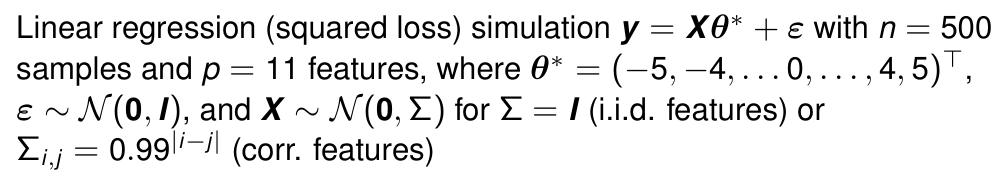



In [15]:
def data_generation_process(option, standardize=True):
    assert option in DGP_OPTIONS, f"Option {option} not in {DGP_OPTIONS}"
    
    match option:
        # (Slide 327/337) y = 3x_1 - 2x_2 + epsilon. epsilon ~ N(0, 1)
        case "3x_1 - 2x_2":
            X = np.random.rand(N_SAMPLES, 2)
            theta_true = np.array([3, -2]).reshape(-1, 1)
            y = X @ theta_true + np.random.randn(N_SAMPLES).reshape(-1,1)
            
        # Slide 1 from https://moodle.lmu.de/pluginfile.php/2688743/mod_folder/content/0/slides-multivar-first-order-12-comparison.pdf?forcedownload=1
        case "optim_slides":
            theta_true = np.arange(-5, 5+1, 1).reshape(-1, 1)
            N_FEATURES = len(theta_true)

            cov_matrix = get_tuplet_structure(CORR_AMOUNT, N_FEATURES)
            X = np.random.multivariate_normal(mean=np.zeros(N_FEATURES), cov=cov_matrix, size=N_SAMPLES) #for _ in range(N_SAMPLES)
            y = X @ theta_true + np.random.randn(N_SAMPLES).reshape(-1,1)
            
        case "california_housing":
            # https://scikit-learn.org/1.5/modules/generated/sklearn.datasets.fetch_california_housing.html
            data = fetch_california_housing()
            X = data.data
            y = data.target.reshape(-1, 1)
            theta_true = None
    
        case "diabetes":
            # https://scikit-learn.org/1.5/modules/generated/sklearn.datasets.load_diabetes.html
            data = load_diabetes()
            X = data.data
            y = data.target.reshape(-1, 1)
            theta_true = None
    
    if standardize:
        if option in ["california_housing", "diabetes"]:
            scaler = StandardScaler()
            X = scaler.fit_transform(X)
    
    return X, y, theta_true

## Getting thetas

In [16]:
def get_thetas(X, y, lmbda, regularization="L1",add_intercept=False):
    """
    Computes the optimal thetas for the linear regression problem with L2 regularization.
    
    Args:
        X (np.ndarray): Data (intercept column will be added later)
        y (np.ndarray): Target
        lmbda (float): Regularization parameter
        regularization (str): L1 or L2 or elastic
        add_intercept (bool): If True, an intercept column will be added to X
    
    ToDO:
    - Here we also penalize the intercept term, I'm not sure if this is what we 
    want for our experiments. Need to figure this our (or preferably, try both)
    
    Note:
        - (This is unrelated to our goal but may be interesting): 
        performing QR decomposition before solving the normal equations did not
        provide any speedup even for large datasets. (We had just learned about
        this from Optimization course and I wanted to benchmark it)
    """
    assert regularization in ["L1", "L2", "elastic"], \
        f"Regularization {regularization} not supported"
    
    if add_intercept:
        X = np.c_[np.ones((n_samples, 1)), X]

    n_samples, n_features = X.shape

    if regularization == "L2":
        LHS = X.T.dot(X) + lmbda*np.eye(n_features)
        RHS = X.T.dot(y)
        
        solution = np.linalg.solve(LHS, RHS).reshape(-1)
    elif regularization == "L1":
        clf = Lasso(alpha=lmbda, fit_intercept=False)
        clf.fit(X, y)
        solution = clf.coef_
        
    elif regularization == "elastic":
        clf = ElasticNet(alpha=lmbda, fit_intercept=False)
        clf.fit(X, y)
        solution = clf.coef_
    
    return solution

## Evaluating relationship tpye

In [17]:
def evaluate_relationships(X, Y):
    """
    Evaluate the strength of various relationships between two features using R^2 scores.
    
    Returns:
        dict: A dictionary where keys are relationship names and values are R^2 scores.
    """
    # https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.linregress.html
    results = {}
    
    def fit_and_score(transform_X=None, transform_Y=None, degree=None):
        transformed_X = transform_X(X) if transform_X else X
        transformed_Y = transform_Y(Y) if transform_Y else Y
                
        if degree:  # Polynomial fit
            coeffs = np.polyfit(transformed_X, transformed_Y, degree)
            Y_pred = np.polyval(coeffs, transformed_X)
            pearson, p_val = pearsonr(transformed_X, transformed_Y)

        else:  # Linear fit
            slope, intercept, pearson, p_val, _ = linregress(transformed_X, transformed_Y)
            Y_pred = slope * transformed_X + intercept

        return {"R2": r2_score(Y, Y_pred), "pearson": pearson, "p_val": p_val}

    def sigmoid(x):
        """Sigmoid function."""
        return 1 / (1 + np.exp(-x))
    

    transformations = {
        "linear": {"transform_X": None, "transform_Y": None, "degree": None},
        "quadratic": {"transform_X": None, "transform_Y": None, "degree": 2},
        "cubic": {"transform_X": None, "transform_Y": None, "degree": 3},
        "log": {"transform_X": np.log, "transform_Y": None, "degree": None},
        "exp": {"transform_X": None, "transform_Y": np.log, "degree": None},
        "sqrt": {"transform_X": np.sqrt, "transform_Y": None, "degree": None},
        "1/x": {"transform_X": None, "transform_Y": lambda x: 1 / x, "degree": None},
        "1/x^2": {"transform_X": None, "transform_Y": lambda x: 1 / x**2, "degree": None},
        "sigmoid": {"transform_X": None, "transform_Y": sigmoid, "degree": None},
        "tanh": {"transform_X": None, "transform_Y": np.tanh, "degree": None},
    }

    for relationship, params in transformations.items():
        try:
            results[relationship] = fit_and_score(**params)
        except Exception as e:
            results[relationship] = {"R2": None, "pearson": None, "p_val": None, "error": str(e)}

    return results


# Contour plots

### Contours of the unregularized loss function

In [18]:
X, y, theta_true = data_generation_process("3x_1 - 2x_2")

In [19]:
def get_contour_plot(X, y, theta_true, lmbda=0, reg="L2", lambdas_pull=None):
    if lambdas_pull is None:
        lambdas_pull = [0.1, 1, 2.5, 5, 10, 20, 100] # same as in the slides
    
    if X.shape[1] != 2:
        raise ValueError("Can't plot, skip this section")
    
    theta_1_vals = np.linspace(MIN_THETA, MAX_THETA, N_VALUES_FOR_EACH_THETA)
    theta_2_vals = np.linspace(MIN_THETA, MAX_THETA, N_VALUES_FOR_EACH_THETA)

    theta_pairs = np.array(np.meshgrid(theta_1_vals, theta_2_vals)).T.reshape(-1, 2)

    df_unreg_risk = pd.DataFrame(theta_pairs, columns=['theta_1', 'theta_2'])
    
    y_pred = X @ theta_pairs.T

    # y is being broadcasted here
    squared_residuals = (y - y_pred)**2
    square_residuals_mean = squared_residuals.mean(axis=0)
    
    if lmbda:
        if reg == "L2":
            square_residuals_mean += lmbda * np.linalg.norm(theta_pairs, axis=1)**2
        elif reg == "L1":
            square_residuals_mean += lmbda * np.linalg.norm(theta_pairs, ord=1, axis=1)
        elif reg == "elastic":
            square_residuals_mean += lmbda * np.linalg.norm(theta_pairs, ord=1, axis=1) + \
                lmbda * np.linalg.norm(theta_pairs, axis=1)**2
        else:
            raise ValueError(f"Unknown regularization type {reg}")
    df_unreg_risk["emp_risk"] = square_residuals_mean

    fig_cont_plot = go.Figure()

    fig_cont_plot.add_trace(go.Contour(
        x=df_unreg_risk["theta_1"],
        y=df_unreg_risk["theta_2"],
        z=df_unreg_risk["emp_risk"],
        colorscale='Viridis',
        showscale=False,
        showlegend=True
    ))

    fig_cont_plot.update_layout(
        title=f'Contour plot of empirical risk for lambda={lmbda} and reg={reg}',
        xaxis_title='theta_1',
        yaxis_title='theta_2'
    )

    # # add horizontal and vertical lines at 0s
    fig_cont_plot.add_shape(
        type='line',
        x0=MIN_THETA, y0=0, x1=MAX_THETA, y1=0,
        line=dict(color='white', width=1)
    )

    fig_cont_plot.add_shape(
        type='line',
        x0=0, y0=MIN_THETA, x1=0, y1=MAX_THETA,
        line=dict(color='white', width=1)
    )

    # add a point for the true theta
    fig_cont_plot.add_trace(go.Scatter(
        x=theta_true[0], y=theta_true[1],
        mode='markers',
        marker=dict(size=10, color='red'),
        name=f'theta_true = {theta_true}'
    ))
    
    for lmbda_pull in lambdas_pull:
        theta1_pull, theta2_pull = get_thetas(X, y, lmbda_pull, regularization=reg)
        fig_cont_plot.add_trace(go.Scatter(
            x=[theta1_pull], y=[theta2_pull],
            mode='markers',
            marker=dict(size=10, color='blue'),
            name=f'lambda = {lmbda_pull} | theta = [{theta1_pull:.2f}, {theta2_pull:.2f}]'
        ))
    fig_cont_plot.show()

In [20]:
get_contour_plot(X, y, theta_true, lmbda=10, reg="L1")

In [51]:
get_thetas(X, y, 0, regularization="L2", add_intercept=False)

array([ 3.18197586, -2.04724368])

# Gathering all the code

In [21]:
config = {"MIN_LAMBDA_LOG_10": MIN_LAMBDA_LOG_10,
        "MAX_LAMBDA_LOG_10": MAX_LAMBDA_LOG_10,
        "NUM_LAMBDAS": NUM_LAMBDAS,
        "LAMBDAS": LAMBDAS,
        "DGP": DGP,
        "MIN_THETA": MIN_THETA,
        "MAX_THETA": MAX_THETA,
        "N_VALUES_FOR_EACH_THETA": N_VALUES_FOR_EACH_THETA,
        "REGULARIZATION": "L1"}
if DGP == "optim_slides":
    config["CORR_AMOUNT"] = CORR_AMOUNT
    


In [22]:
def do_all(config, reporting=True):
    dgp, reg = config["DGP"], config["REGULARIZATION"]
    if not os.path.exists('out'):
        os.makedirs('out')
    subfolder = os.path.join('out', f"{dgp}_{reg}")
    if not os.path.exists(subfolder):
        os.makedirs(subfolder)
    
    if reporting:    
        report = {}
        report["datetime"] = pd.Timestamp.now().strftime("%Y-%m-%d %H:%M:%S")
        for i, j in config.items():
            report[i] = j
        
    logging.info(f"DPG: {dgp} | Regularization: {reg}")
    
    X, y, theta_true = data_generation_process(dgp)
    logging.debug(f"\tStep 0: DPG done | X shape: {X.shape} | y shape: {y.shape}")
    
    print("ATT, theta_true", theta_true)
    theta_analytic = get_thetas(X, y, 0, regularization=reg, add_intercept=False)
    logging.debug(f"\tStep 1: Analytic solution done | Theta: {theta_analytic}")
    
    if dgp in ["3x_1 - 2x_2", "optim_slides"]:
        if np.linalg.norm(theta_analytic.reshape(-1,1) - theta_true) < 0.5:
            logging.warning(f'\tAnalytic solution is quite far {theta_analytic} != {theta_true}')
            
    theta_dict = {
        lmbda: get_thetas(X, y, lmbda, regularization=reg) \
            for lmbda in config["LAMBDAS"]
    }
    logging.debug(f"\tStep 2: Thetas for different lambdas done")
    
    # getting thetas for different lambdas
    df_thetas_per_lambda = pd.DataFrame(theta_dict).T
    
    df_thetas_per_lambda.reset_index(inplace=True)
    df_thetas_per_lambda.rename(columns={"index": "lambda"}, inplace=True)
    df_thetas_per_lambda.rename(columns={i: f"theta_{i}" for i in range(X.shape[1])}, inplace=True)

    coef_cols = [f"theta_{i}" for i in range(X.shape[1])]

    df_thetas_per_lambda["L1_norm"] = df_thetas_per_lambda[coef_cols].apply(lambda x: 
        np.linalg.norm(x, ord=1), axis=1)
    df_thetas_per_lambda["L2_norm"] = df_thetas_per_lambda[coef_cols].apply(lambda x: 
        np.linalg.norm(x, ord=2)**2, axis=1)
    
    logging.debug(f"\tStep 3: Norms computed")

    plots = create_plots(df_thetas_per_lambda, ['L1_norm', 'L2_norm'], dgp, reg)

    # Accessing individual plots
    fig_rel_l1, fig_rel_l1_log_lambda, fig_rel_l1_narrow_x, fig_rel_l1_super_narrow_x = plots['L1_norm'].values()
    fig_rel_l2, fig_rel_l2_log_lambda, fig_rel_l2_narrow_x, fig_rel_l2_super_narrow_x = plots['L2_norm'].values()
    fig_combined, fig_combined_log, fig_combined_narrow, fig_combined_super_narrow = plots['combined'].values()

    
    logging.debug(f"\tStep 4: Plots done")
    # save all the figures
    all_figures = [
        fig_rel_l1, fig_rel_l1_log_lambda, fig_rel_l1_narrow_x, fig_rel_l1_super_narrow_x,
        fig_rel_l2, fig_rel_l2_log_lambda, fig_rel_l2_narrow_x, fig_rel_l2_super_narrow_x,
        fig_combined, fig_combined_log, fig_combined_narrow, fig_combined_super_narrow
    ]

    all_names = [
        "lambda_l1_norm_rel", "lambda_l1_norm_rel_log_lambda", "lambda_l1_norm_rel_narrow_x", "lambda_l1_norm_rel_super_narrow_x",
        "lambda_l2_norm_rel", "lambda_l2_norm_rel_log_lambda", "lambda_l2_norm_rel_narrow_x", "lambda_l2_norm_rel_super_narrow",
        "lambda_combined_norm_rel", "lambda_combined_norm_rel_log_lambda", "lambda_combined_norm_rel_narrow_x", "lambda_combined_norm_rel_super_narrow"
    ]

    # Save figures to HTML and update the report if reporting is enabled
    for fig, name in zip(all_figures, all_names):
        file_path = os.path.join(subfolder, f"{name}.html")
        fig.write_html(file_path)
        if reporting:
            report[f"{name}_file"] = file_path
        
    logging.debug(f"\tStep 5: Figures saved")
    
    relationship_l1_norm = evaluate_relationships(df_thetas_per_lambda["lambda"], df_thetas_per_lambda["L1_norm"])
    relationship_l2_norm = evaluate_relationships(df_thetas_per_lambda["lambda"], df_thetas_per_lambda["L2_norm"])
    
    if reporting:
        report["relationship_l1_norm"] = relationship_l1_norm
        report["relationship_l2_norm"] = relationship_l2_norm
    logging.debug(f"\tStep 6: Relationships evaluated")
    
    
    logging.info(f"Done")
    if reporting:
        report["N_SAMPLES"] = X.shape[0]
        report["N_FEATURES"] = X.shape[1]
        report["THETA_TRUE"] = theta_true
    
    # make all numpy arrays into lists for json serialization
    for k, v in report.items():
        if isinstance(v, np.ndarray):
            report[k] = v.tolist()
            
    KEYS_TO_DROP = ["LAMBDAS"]        
    report = {k: v for k, v in report.items() if k not in KEYS_TO_DROP}
    
    with open(os.path.join(subfolder, "report.json"), 'w') as f:
        json.dump(report, f)

In [36]:
config = {"MIN_LAMBDA_LOG_10": -5,
        "MAX_LAMBDA_LOG_10": 5,
        "NUM_LAMBDAS": NUM_LAMBDAS,
        "LAMBDAS": np.logspace(-5, 5, NUM_LAMBDAS),
        "DGP": "optim_slides",
        "MIN_THETA": MIN_THETA,
        "MAX_THETA": MAX_THETA,
        "N_VALUES_FOR_EACH_THETA": N_VALUES_FOR_EACH_THETA,
        "REGULARIZATION": "L2"}
if DGP == "optim_slides":
    config["CORR_AMOUNT"] = CORR_AMOUNT
    


In [37]:
do_all(config)

ATT, theta_true [[-5]
 [-4]
 [-3]
 [-2]
 [-1]
 [ 0]
 [ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]]


In [38]:
for dgp in tqdm(DGP_OPTIONS):
# for dgp in ["optim_slides"]:
    for reg in ["L1", "L2", "elastic"]:
        config["REGULARIZATION"] = reg
        config["DGP"] = dgp    
        if reg == "L2":
            config["MIN_LAMBDA_LOG_10"] = -5
            config["MAX_LAMBDA_LOG_10"] = 5
        else:
            config["MIN_LAMBDA_LOG_10"] = -2
            config["MAX_LAMBDA_LOG_10"] = 2
        do_all(config, reporting=True)

  0%|          | 0/4 [00:00<?, ?it/s]c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\base.py:1473: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.342e+02, tolerance: 2.253e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

2024-12-09 05:42:05 - WARNING - 	Analytic solution is quite fa

ATT, theta_true [[ 3]
 [-2]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages

ATT, theta_true [[ 3]
 [-2]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\base.py:1473: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.741e+02, tolerance: 2.277e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

2024-12-09 05:43:45 - WARNING - 	Analytic solution is quite far [ 2.96572159 -1.85995979] != [[ 3]


ATT, theta_true [[ 3]
 [-2]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages

ATT, theta_true [[-5]
 [-4]
 [-3]
 [-2]
 [-1]
 [ 0]
 [ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages

ATT, theta_true [[-5]
 [-4]
 [-3]
 [-2]
 [-1]
 [ 0]
 [ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\base.py:1473: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.805e+02, tolerance: 2.775e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.



ATT, theta_true [[-5]
 [-4]
 [-3]
 [-2]
 [-1]
 [ 0]
 [ 1]
 [ 2]
 [ 3]
 [ 4]
 [ 5]]


c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages

ATT, theta_true None


c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.957e+04, tolerance: 1.158e+01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWa

ATT, theta_true None
ATT, theta_true None


c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\base.py:1473: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.957e+04, tolerance: 1.158e+01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

div

ATT, theta_true None


c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

divide by zero encountered in log

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning:

invalid value encountered in subtract

c:\Users\hayk_\.conda\envs\100\lib\site-packages

ATT, theta_true None
ATT, theta_true None


c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\base.py:1473: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:697: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.747e+06, tolerance: 1.285e+03 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

c:\Users\hayk_\.conda\envs\100\lib\site-packages\pandas\core\arraylike.py:396: RuntimeWarning:

div

## Stupid problems require stupid solutions (taking screenshots of htmls of the plots)

In [39]:
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from webdriver_manager.chrome import ChromeDriverManager
import time

def html_to_png(html_path, output_path, width=1200, height=800):
    # Set up the Selenium WebDriver
    options = webdriver.ChromeOptions()
    options.add_argument('--headless')
    options.add_argument('--disable-gpu')
    options.add_argument(f'--window-size={width},{height}')
    driver = webdriver.Chrome(service=Service(ChromeDriverManager().install()), options=options)
    
    try:
        # Load the HTML file
        driver.get(f"file://{html_path}")
        
        # Wait for the plot to fully render
        time.sleep(2)  # Adjust sleep time as needed for complex plots
        
        # Take a screenshot and save it as PNG
        driver.save_screenshot(output_path)
        print(f"Plot saved as PNG: {output_path}")
    finally:
        # Quit the browser
        driver.quit()

In [40]:
from concurrent.futures import ThreadPoolExecutor



FOLDER = r"C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out"

# if not os.path.exists(FOLDER):
#     os.makedirs(os.path.join(FOLDER, "png"))

# reconfig logger to warning level
logging.getLogger().setLevel(logging.WARNING)
def process_html(exp, html):
    if not html.endswith(".html"):
        return
    if not "combined" in html:
        return
    html_path = os.path.join(FOLDER, exp, html)
    png_path = os.path.join(FOLDER, exp, html.replace(".html", ".png"))
    html_to_png(html_path, png_path)

with ThreadPoolExecutor() as executor:
    for exp in tqdm(os.listdir(FOLDER)):
        if not os.path.isdir(os.path.join(FOLDER, exp)):
            continue
        html_files = os.listdir(os.path.join(FOLDER, exp))
        executor.map(lambda html: process_html(exp, html), html_files)

100%|██████████| 12/12 [00:00<00:00, 153.71it/s]


Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\3x_1 - 2x_2_L1\lambda_combined_norm_rel_narrow_x.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\3x_1 - 2x_2_elastic\lambda_combined_norm_rel_narrow_x.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\california_housing_elastic\lambda_combined_norm_rel_log_lambda.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\3x_1 - 2x_2_elastic\lambda_combined_norm_rel_super_narrow.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\california_housing_elastic\lambda_combined_norm_rel.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\3x_1 - 2x_2_L1\lambda_combined_norm_rel_super_narrow.png
Plot saved as PNG: C:\Users\hayk_\OneDrive\Desktop\SL\regularization_lambda_t\out\3x_1 - 2x_2_elastic\lambda_combined_norm_rel_log_lambda.png
Plot saved as

# Misc

## Animated contour plots for various lambdas

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from ipywidgets import interact

# Constants
MIN_THETA = -10
MAX_THETA = 10
N_VALUES_FOR_EACH_THETA = 100

def get_contour_plot_with_controls(X, y, theta_true):
    theta_1_vals = np.linspace(MIN_THETA, MAX_THETA, N_VALUES_FOR_EACH_THETA)
    theta_2_vals = np.linspace(MIN_THETA, MAX_THETA, N_VALUES_FOR_EACH_THETA)
    theta_pairs = np.array(np.meshgrid(theta_1_vals, theta_2_vals)).T.reshape(-1, 2)
    
    # Values of lambda and regularization types
    lambdas = [0, 0.1, 1, 2.5, 5, 10, 20, 100]
    regularization_types = ["L1", "L2", "elastic"]
    
    # Generate frames for each combination of lambda and regularization
    frames = []
    for reg in regularization_types:
        for lmbda in lambdas:
            df_unreg_risk = pd.DataFrame(theta_pairs, columns=['theta_1', 'theta_2'])
            
            y_pred = X @ theta_pairs.T
            squared_residuals = (y - y_pred)**2
            square_residuals_mean = squared_residuals.mean(axis=0)
            
            if lmbda:
                if reg == "L2":
                    square_residuals_mean += lmbda * np.linalg.norm(theta_pairs, axis=1)**2
                elif reg == "L1":
                    square_residuals_mean += lmbda * np.linalg.norm(theta_pairs, ord=1, axis=1)
                elif reg == "elastic":
                    square_residuals_mean += lmbda * (np.linalg.norm(theta_pairs, ord=1, axis=1) +
                                                      np.linalg.norm(theta_pairs, axis=1)**2)
                else:
                    raise ValueError(f"Unknown regularization type {reg}")
            
            df_unreg_risk["emp_risk"] = square_residuals_mean
            
            # Create a frame for each combination of lambda and regularization
            frame_name = f"{reg}_{lmbda}"
            frame = go.Frame(
                data=[
                    go.Contour(
                        x=df_unreg_risk["theta_1"],
                        y=df_unreg_risk["theta_2"],
                        z=df_unreg_risk["emp_risk"],
                        colorscale='Viridis',
                        showscale=False
                    )
                ],
                name=frame_name
            )
            frames.append(frame)
    
    # Base figure for the initial lambda and regularization type
    initial_lmbda = lambdas[0]
    initial_reg = regularization_types[0]
    df_initial = pd.DataFrame(theta_pairs, columns=['theta_1', 'theta_2'])
    y_pred = X @ theta_pairs.T
    squared_residuals = (y - y_pred)**2
    square_residuals_mean = squared_residuals.mean(axis=0)
    square_residuals_mean += initial_lmbda * np.linalg.norm(theta_pairs, axis=1)**2
    df_initial["emp_risk"] = square_residuals_mean

    fig = go.Figure(
        data=[
            go.Contour(
                x=df_initial["theta_1"],
                y=df_initial["theta_2"],
                z=df_initial["emp_risk"],
                colorscale='Viridis',
                showscale=False
            )
        ],
        layout=go.Layout(
            title=f'Contour plot of empirical risk for lambda={initial_lmbda} and reg={initial_reg}',
            xaxis_title='theta_1',
            yaxis_title='theta_2',
            updatemenus=[
                dict(
                    type="buttons",
                    buttons=[
                        dict(label="Play",
                             method="animate",
                             args=[None, {"frame": {"duration": 500, "redraw": True},
                                          "fromcurrent": True}]),
                        dict(label="Pause",
                             method="animate",
                             args=[[None], {"frame": {"duration": 0, "redraw": True},
                                            "mode": "immediate"}])
                    ]
                ),
                dict(
                    type="dropdown",
                    buttons=[
                        dict(
                            args=[{"title": f"Contour plot of empirical risk for lambda={lambdas[0]} and reg={reg}"}],
                            label=reg,
                            method="update"
                        ) for reg in regularization_types
                    ],
                    direction="down",
                    showactive=True,
                    x=0.8,
                    xanchor="left",
                    y=1.1,
                    yanchor="top"
                )
            ]
        ),
        frames=frames
    )
    
    # Add slider for lambda
    fig.update_layout(
        sliders=[{
            "steps": [
                {
                    "args": [[f"{reg}_{lmbda}"], {"frame": {"duration": 300, "redraw": True},
                                                  "mode": "immediate"}],
                    "label": f"{lmbda}",
                    "method": "animate"
                } for reg in regularization_types for lmbda in lambdas
            ],
            "transition": {"duration": 300},
            "x": 0.1,
            "y": 0,
            "currentvalue": {"font": {"size": 20}, "prefix": "Lambda: ", "visible": True, "xanchor": "right"},
            "len": 0.9
        }]
    )

    fig.show()





In [35]:
get_contour_plot_with_controls(X, y, theta_true)

## The other way around

In [564]:
import numpy as np
from scipy.optimize import minimize

# Generate synthetic data
np.random.seed(42)
n_samples, n_features = 100, 5
X = np.random.randn(n_samples, n_features)
true_beta = np.random.randn(n_features)
y = X @ true_beta + np.random.randn(n_samples) * 0.5  # Add some noise

# Ridge regression using constrained optimization
def ridge_constrained(beta, X, y):
    """
    Objective function for Ridge regression with constraints.
    
    Parameters:
        beta: Coefficients to optimize (vector of shape (n_features,))
        X: Design matrix (shape (n_samples, n_features))
        y: Target vector (shape (n_samples,))
        
    Returns:
        Loss value
    """
    residual = y - X @ beta
    return 0.5 * np.sum(residual ** 2)

# Constraint: norm(beta)^2 <= c
def constraint(beta, c):
    return c - np.sum(beta ** 2)

# Parameters
c_value = 10  # Constraint value for the norm
initial_beta = np.zeros(n_features)

# Define the constraint for the optimizer
constraints = {'type': 'ineq', 'fun': lambda beta: constraint(beta, c_value)}

# Minimize the objective function with constraints
result = minimize(
    ridge_constrained,
    initial_beta,
    args=(X, y),
    method='SLSQP',  # Sequential Least Squares Quadratic Programming
    constraints=constraints
)

# Extract the optimized coefficients
constrained_beta = result.x

# Print results
print("Optimized coefficients (constrained):", constrained_beta)
print("Norm of coefficients (squared):", np.sum(constrained_beta ** 2))
print("Constraint value (c):", c_value)


Optimized coefficients (constrained): [ 0.91395485  1.87915042 -1.35490377  0.58833439 -0.53157716]
Norm of coefficients (squared): 6.830995608349117
Constraint value (c): 10
